# Latent Space Unicity Test

In [1]:
import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))
import numpy as np
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())
import math
import matplotlib.pyplot as plt
import tensorflow as tf
import tensorflow_datasets as tfds
from tensorflow import keras
from keras import layers

Num GPUs Available:  1
[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 3205395369138790304
xla_global_id: -1
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 14343274496
locality {
  bus_id: 1
  links {
  }
}
incarnation: 11604669203463367552
physical_device_desc: "device: 0, name: Tesla T4, pci bus id: 0000:00:04.0, compute capability: 7.5"
xla_global_id: 416903419
]


In [2]:

dataset_name = "oxford_flowers102"
dataset_repetitions = 5#5
num_epochs = 20  # train for at least 50 epochs for good results
image_size = 64

# KID = Kernel Inception Distance, see related section

kid_image_size = 75
kid_diffusion_steps = 5
plot_diffusion_steps = 20

# sampling

min_signal_rate = 0.02
max_signal_rate = 0.95

# architecture

embedding_dims = 32 # 32
embedding_max_frequency = 1000.0
widths = [32, 64, 96, 128]
#widths = [48, 96, 192, 384]
block_depth = 2

# optimization

batch_size = 64
ema = 0.999
learning_rate = 1e-3
weight_decay = 1e-4

In [3]:
def preprocess_image(data):
    # center crop image
    height = tf.shape(data["image"])[0]
    width = tf.shape(data["image"])[1]
    crop_size = tf.minimum(height, width)
    image = tf.image.crop_to_bounding_box(
        data["image"],
        (height - crop_size) // 2,
        (width - crop_size) // 2,
        crop_size,
        crop_size,
    )

    # resize and clip
    # for image downsampling it is important to turn on antialiasing
    image = tf.image.resize(image, size=[image_size, image_size], antialias=True)
    return tf.clip_by_value(image / 255.0, 0.0, 1.0)


def prepare_dataset(split):
    # the validation dataset is shuffled as well, because data order matters
    # for the KID estimation
    return (
        tfds.load(dataset_name, split=split, shuffle_files=True)
        .map(preprocess_image, num_parallel_calls=tf.data.AUTOTUNE)
        .cache()
        .repeat(dataset_repetitions)
        .shuffle(10 * batch_size)
        .batch(batch_size, drop_remainder=True)
        .prefetch(buffer_size=tf.data.AUTOTUNE)
    )


# load dataset
train_dataset = prepare_dataset("train[:80%]+validation[:80%]+test[:80%]")
val_dataset = prepare_dataset("train[80%:]+validation[80%:]+test[80%:]")

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Shuffling /root/tensorflow_datasets/oxford_flowers102/2.1.1.incompleteX53DYV/oxford_flowers102-train.tfrecord*…

Generating test examples...: 0 examples [00:00, ? examples/s]

Shuffling /root/tensorflow_datasets/oxford_flowers102/2.1.1.incompleteX53DYV/oxford_flowers102-test.tfrecord*.…

Generating validation examples...: 0 examples [00:00, ? examples/s]

Shuffling /root/tensorflow_datasets/oxford_flowers102/2.1.1.incompleteX53DYV/oxford_flowers102-validation.tfre…

Dataset oxford_flowers102 downloaded and prepared to /root/tensorflow_datasets/oxford_flowers102/2.1.1. Subsequent calls will reuse this data.


In [4]:
def sinusoidal_embedding(x):
    embedding_min_frequency = 1.0
    frequencies = tf.exp(
        tf.linspace(
            tf.math.log(embedding_min_frequency),
            tf.math.log(embedding_max_frequency),
            embedding_dims // 2,
        )
    )
    angular_speeds = 2.0 * math.pi * frequencies
    embeddings = tf.concat(
        [tf.sin(angular_speeds * x), tf.cos(angular_speeds * x)], axis=3
    )
    return embeddings


def ResidualBlock(width):
    def apply(x):
        input_width = x.shape[3]
        if input_width == width:
            residual = x
        else:
            residual = layers.Conv2D(width, kernel_size=1)(x)
        x = layers.BatchNormalization(center=False, scale=False)(x)
        x = layers.Conv2D(
            width, kernel_size=3, padding="same", activation=keras.activations.swish
        )(x)
        x = layers.Conv2D(width, kernel_size=3, padding="same")(x)
        x = layers.Add()([x, residual])
        return x

    return apply


def DownBlock(width, block_depth):
    def apply(x):
        x, skips = x
        for _ in range(block_depth):
            x = ResidualBlock(width)(x)
            skips.append(x)
        x = layers.AveragePooling2D(pool_size=2)(x)
        return x

    return apply


def UpBlock(width, block_depth):
    def apply(x):
        x, skips = x
        x = layers.UpSampling2D(size=2, interpolation="bilinear")(x)
        for _ in range(block_depth):
            x = layers.Concatenate()([x, skips.pop()])
            x = ResidualBlock(width)(x)
        return x

    return apply


def get_network(image_size, widths, block_depth):
    noisy_images = keras.Input(shape=(image_size, image_size, 3))
    noise_variances = keras.Input(shape=(1, 1, 1))

    e = layers.Lambda(sinusoidal_embedding)(noise_variances)
    e = layers.UpSampling2D(size=image_size, interpolation="nearest")(e)

    x = layers.Conv2D(widths[0], kernel_size=1)(noisy_images)
    x = layers.Concatenate()([x, e])

    skips = []
    for width in widths[:-1]:
        x = DownBlock(width, block_depth)([x, skips])

    for _ in range(block_depth):
        x = ResidualBlock(widths[-1])(x)

    for width in reversed(widths[:-1]):
        x = UpBlock(width, block_depth)([x, skips])

    x = layers.Conv2D(3, kernel_size=1, kernel_initializer="zeros")(x)

    return keras.Model([noisy_images, noise_variances], x, name="residual_unet")

In [5]:
def get_unet(image_size, widths, block_depth):
    noisy_images = keras.Input(shape=(image_size, image_size, 3))
    #noise_variances = keras.Input(shape=(1, 1, 1))

    #e = layers.Lambda(sinusoidal_embedding)(noise_variances)
    #e = layers.UpSampling2D(size=image_size, interpolation="nearest")(e)

    x = layers.Conv2D(widths[0], kernel_size=1)(noisy_images)
    #x = layers.Concatenate()([x, e])

    skips = []
    for width in widths[:-1]:
        x = DownBlock(width, block_depth)([x, skips])

    for _ in range(block_depth):
        x = ResidualBlock(widths[-1])(x)

    for width_foo in reversed(widths[:-1]):
        x = UpBlock(width, block_depth)([x, skips])

    x = layers.Conv2D(3, kernel_size=1, kernel_initializer="zeros")(x)

    return keras.Model([noisy_images], x, name="residual_unet")

In [6]:
#coding=utf-8
import tensorflow as tf 
from keras.models import *
from keras.layers import *

def conv_block(input, filters):
    out = Conv2D(filters, kernel_size=(3,3), strides=1, padding='same')(input)
    out = BatchNormalization()(out)
    out = Activation('relu')(out)
    out = Conv2D(filters, kernel_size=(3,3), strides=1, padding='same')(out)
    out = BatchNormalization()(out)
    out = Activation('relu')(out)
    return out

def up_conv(input, filters):
    out = UpSampling2D()(input)
    out = Conv2D(filters, kernel_size=(3,3), strides=1, padding='same')(out)
    out = BatchNormalization()(out)
    out = Activation('relu')(out)
    return out

def Attention_block(input1, input2, filters):
    g1 = Conv2D(filters, kernel_size=1, strides=1, padding='same')(input1)
    g1 = BatchNormalization()(g1)
    x1 = Conv2D(filters, kernel_size=1, strides=1, padding='same')(input2)
    x1 = BatchNormalization()(x1)
    psi = Activation('relu')(add([g1, x1]))
    psi = Conv2D(filters, kernel_size=1, strides=1, padding='same')(psi)
    psi = BatchNormalization()(psi)
    psi = Activation('sigmoid')(psi)
    out = multiply([input2, psi])
    return out
    

def getAttUNet(image_size, widths, block_depth):

    noisy_images = keras.Input(shape=(image_size, image_size, 3))
    noise_variances = keras.Input(shape=(1, 1, 1))

    e = layers.Lambda(sinusoidal_embedding)(noise_variances)
    e = layers.UpSampling2D(size=image_size, interpolation="nearest")(e)

    x = layers.Conv2D(widths[0], kernel_size=1)(noisy_images)
    x = layers.Concatenate()([x, e])
    
    n1 = 32
    filters = [n1, n1 * 2, n1 * 4, n1 * 8, n1 * 16]

    e1 = conv_block(x, filters[0])

    e2 = MaxPooling2D(strides=2)(e1)
    e2 = conv_block(e2, filters[1])

    e3 = MaxPooling2D(strides=2)(e2)
    e3 = conv_block(e3, filters[2])

    e4 = MaxPooling2D(strides=2)(e3)
    e4 = conv_block(e4, filters[3])

    e5 = MaxPooling2D(strides=2)(e4)
    e5 = conv_block(e5, filters[4])

    d5 = up_conv(e5, filters[3])
    x4 =  Attention_block(d5, e4, filters[3])
    d5 = Concatenate()([x4, d5])
    d5 = conv_block(d5, filters[3])

    d4 = up_conv(d5, filters[2])
    x3 =  Attention_block(d4, e3, filters[2])
    d4 = Concatenate()([x3, d4])
    d4 = conv_block(d4, filters[2])

    d3 = up_conv(d4, filters[1])
    x2 =  Attention_block(d3, e2, filters[1])
    d3 = Concatenate()([x2, d3])
    d3 = conv_block(d3, filters[1])

    d2 = up_conv(d3, filters[0])
    x1 =  Attention_block(d2, e1, filters[0])
    d2 = Concatenate()([x1, d2])
    d2 = conv_block(d2, filters[0])

    x = layers.Conv2D(3, kernel_size=1, kernel_initializer="zeros")(d2)

    return keras.Model([noisy_images, noise_variances], x, name="residual_unet" )

In [28]:
from keras.layers import *
from keras.models import *
from keras.optimizers import *
def get_VGGUnet(image_size=224, widths=None, block_depth=None):
    # Block 1
    noisy_images = keras.Input(shape=(image_size, image_size, 3))
    noise_variances = keras.Input(shape=(1, 1, 1))

    e = layers.Lambda(sinusoidal_embedding)(noise_variances)
    e = layers.UpSampling2D(size=image_size, interpolation="nearest")(e)

    x = layers.Conv2D(widths[0], kernel_size=1)(noisy_images)
    x = layers.Concatenate()([x, e])

    x = Conv2D(64, (3, 3), padding='same', name='block1_conv1')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(64, (3, 3), padding='same', name='block1_conv2')(x)
    x = BatchNormalization()(x)
    block_1_out = Activation('relu')(x)

    x = MaxPooling2D()(block_1_out)

    # Block 2
    x = Conv2D(128, (3, 3), padding='same', name='block2_conv1')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(128, (3, 3), padding='same', name='block2_conv2')(x)
    x = BatchNormalization()(x)
    block_2_out = Activation('relu')(x)

    x = MaxPooling2D()(block_2_out)

    # Block 3
    x = Conv2D(256, (3, 3), padding='same', name='block3_conv1')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(256, (3, 3), padding='same', name='block3_conv2')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(256, (3, 3), padding='same', name='block3_conv3')(x)
    x = BatchNormalization()(x)
    block_3_out = Activation('relu')(x)

    x = MaxPooling2D()(block_3_out)

    # Block 4
    x = Conv2D(512, (3, 3), padding='same', name='block4_conv1')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(512, (3, 3), padding='same', name='block4_conv2')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(512, (3, 3), padding='same', name='block4_conv3')(x)
    x = BatchNormalization()(x)
    block_4_out = Activation('relu')(x)

    x = MaxPooling2D()(block_4_out)

    # Block 5
    x = Conv2D(512, (3, 3), padding='same', name='block5_conv1')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(512, (3, 3), padding='same', name='block5_conv2')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(512, (3, 3), padding='same', name='block5_conv3')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    for_pretrained_weight = MaxPooling2D()(x)

    # UP 1
    x = Conv2DTranspose(512, (2, 2), strides=(2, 2), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = concatenate([x, block_4_out])
    x = Conv2D(512, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(512, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    # UP 2
    x = Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = concatenate([x, block_3_out])
    x = Conv2D(256, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(256, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    # UP 3
    x = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = concatenate([x, block_2_out])
    x = Conv2D(128, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(128, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    # UP 4
    x = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = concatenate([x, block_1_out])
    x = Conv2D(64, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = Conv2D(64, (3, 3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)

    x = layers.Conv2D(3, kernel_size=1, kernel_initializer="zeros")(x)

    return keras.Model([noisy_images, noise_variances], x, name="residual_unet")

In [29]:
class DiffusionModel(keras.Model):
    def __init__(self, image_size, widths, block_depth):
        super().__init__()

        self.normalizer = layers.Normalization()
        self.network = get_VGGUnet(image_size, widths, block_depth)
        self.ema_network = keras.models.clone_model(self.network)

    def compile(self, **kwargs):
        super().compile(**kwargs)

        self.noise_loss_tracker = keras.metrics.Mean(name="n_loss")
        self.image_loss_tracker = keras.metrics.Mean(name="i_loss")
        #self.kid = KID(name="kid")

    @property
    def metrics(self):
        return [self.noise_loss_tracker, self.image_loss_tracker]

    def denormalize(self, images):
        # convert the pixel values back to 0-1 range
        images = self.normalizer.mean + images * self.normalizer.variance**0.5
        return tf.clip_by_value(images, 0.0, 1.0)

    def diffusion_schedule(self, diffusion_times):
        # diffusion times -> angles
        start_angle = tf.acos(max_signal_rate)
        end_angle = tf.acos(min_signal_rate)

        diffusion_angles = start_angle + diffusion_times * (end_angle - start_angle)

        # angles -> signal and noise rates
        signal_rates = tf.cos(diffusion_angles)
        noise_rates = tf.sin(diffusion_angles)
        # note that their squared sum is always: sin^2(x) + cos^2(x) = 1

        return noise_rates, signal_rates

    def denoise(self, noisy_images, noise_rates, signal_rates, training):
        # the exponential moving average weights are used at evaluation
        if training:
            network = self.network
        else:
            network = self.ema_network

        # predict noise component and calculate the image component using it
        pred_noises = network([noisy_images, noise_rates**2], training=training)
        pred_images = (noisy_images - noise_rates * pred_noises) / signal_rates

        return pred_noises, pred_images

    def reverse_diffusion(self, initial_noise, diffusion_steps):
        # reverse diffusion = sampling
        num_images = initial_noise.shape[0]
        step_size = 1.0 / diffusion_steps

        # important line:
        # at the first sampling step, the "noisy image" is pure noise
        # but its signal rate is assumed to be nonzero (min_signal_rate)
        next_noisy_images = initial_noise
        for step in range(diffusion_steps):
            noisy_images = next_noisy_images

            # separate the current noisy image to its components
            diffusion_times = tf.ones((num_images, 1, 1, 1)) - step * step_size
            noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
            pred_noises, pred_images = self.denoise(
                noisy_images, noise_rates, signal_rates, training=False
            )
            # network used in eval mode

            # remix the predicted components using the next signal and noise rates
            next_diffusion_times = diffusion_times - step_size
            next_noise_rates, next_signal_rates = self.diffusion_schedule(
                next_diffusion_times
            )
            next_noisy_images = (
                next_signal_rates * pred_images + next_noise_rates * pred_noises
            )
            # this new noisy image will be used in the next step

        return pred_images

    def generate(self, num_images, diffusion_steps):
        # noise -> images -> denormalized images
        initial_noise = tf.random.normal(shape=(num_images, image_size, image_size, 3))
        generated_images = self.reverse_diffusion(initial_noise, diffusion_steps)
        generated_images = self.denormalize(generated_images)
        return generated_images

    def train_step(self, images):
        # normalize images to have standard deviation of 1, like the noises
        images = self.normalizer(images, training=True)
        noises = tf.random.normal(shape=(batch_size, image_size, image_size, 3))

        # sample uniform random diffusion times
        diffusion_times = tf.random.uniform(
            shape=(batch_size, 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
        # mix the images with noises accordingly
        noisy_images = signal_rates * images + noise_rates * noises

        with tf.GradientTape() as tape:
            # train the network to separate noisy images to their components
            pred_noises, pred_images = self.denoise(
                noisy_images, noise_rates, signal_rates, training=True
            )

            noise_loss = self.loss(noises, pred_noises)  # used for training
            image_loss = self.loss(images, pred_images)  # only used as metric

        gradients = tape.gradient(noise_loss, self.network.trainable_weights)
        self.optimizer.apply_gradients(zip(gradients, self.network.trainable_weights))

        self.noise_loss_tracker.update_state(noise_loss)
        self.image_loss_tracker.update_state(image_loss)

        # track the exponential moving averages of weights
        for weight, ema_weight in zip(self.network.weights, self.ema_network.weights):
            ema_weight.assign(ema * ema_weight + (1 - ema) * weight)

        # KID is not measured during the training phase for computational efficiency
        return {m.name: m.result() for m in self.metrics}

    def test_step(self, images):
        # normalize images to have standard deviation of 1, like the noises
        images = self.normalizer(images, training=False)
        noises = tf.random.normal(shape=(batch_size, image_size, image_size, 3))

        # sample uniform random diffusion times
        diffusion_times = tf.random.uniform(
            shape=(batch_size, 1, 1, 1), minval=0.0, maxval=1.0
        )
        noise_rates, signal_rates = self.diffusion_schedule(diffusion_times)
        # mix the images with noises accordingly
        noisy_images = signal_rates * images + noise_rates * noises

        # use the network to separate noisy images to their components
        pred_noises, pred_images = self.denoise(
            noisy_images, noise_rates, signal_rates, training=False
        )

        noise_loss = self.loss(noises, pred_noises)
        image_loss = self.loss(images, pred_images)

        self.image_loss_tracker.update_state(image_loss)
        self.noise_loss_tracker.update_state(noise_loss)

        # measure KID between real and generated images
        # this is computationally demanding, kid_diffusion_steps has to be small
        images = self.denormalize(images)
        generated_images = self.generate(
            num_images=batch_size, diffusion_steps=kid_diffusion_steps
        )
        #self.kid.update_state(images, generated_images)

        return {m.name: m.result() for m in self.metrics}

    def plot_images(self, epoch=None, logs=None, num_rows=3, num_cols=6):
        # plot random generated images for visual evaluation of generation quality
        generated_images = self.generate(
            num_images=num_rows * num_cols,
            diffusion_steps=plot_diffusion_steps,
        )

        plt.figure(figsize=(num_cols * 2.0, num_rows * 2.0))
        for row in range(num_rows):
            for col in range(num_cols):
                index = row * num_cols + col
                plt.subplot(num_rows, num_cols, index + 1)
                plt.imshow(generated_images[index])
                plt.axis("off")
        plt.tight_layout()
        plt.show()
        plt.close()

In [8]:
#!pip install tensorflow_addons

In [30]:

model = DiffusionModel(image_size, widths, block_depth)

checkpoint_path = "./hello/"
# below tensorflow 2.9:
#!pip install tensorflow_addons
#import tensorflow_addons as tfa
optimizer=keras.optimizers.experimental.AdamW
model.compile(
    optimizer=optimizer(
        learning_rate=learning_rate, weight_decay=weight_decay
    ),
    loss=keras.losses.mean_absolute_error,
)
# pixelwise mean absolute error is used as loss

# save the best model based on thmodel.load_weights(checkpoint_path)e validation KID metric
checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    filepath=checkpoint_path,
    save_weights_only=True,
    #monitor="val_kid",
    mode="min",
    save_best_only=True,
)

# calculate mean and variance of training dataset for normalization
model.normalizer.adapt(train_dataset)
#model.set_weights(test)

Epoch 1/20
511/511 [==============================] - ETA: 0s - n_loss: 0.2208 - i_loss: 0.4853

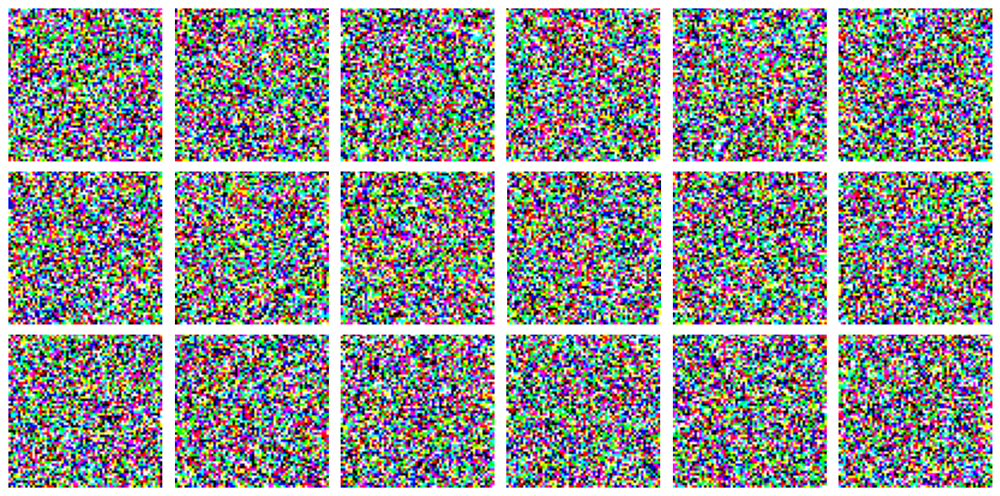

511/511 [==============================] - 174s 276ms/step - n_loss: 0.2208 - i_loss: 0.4853 - val_n_loss: 0.7935 - val_i_loss: 2.5024
Epoch 2/20
511/511 [==============================] - ETA: 0s - n_loss: 0.1683 - i_loss: 0.3142

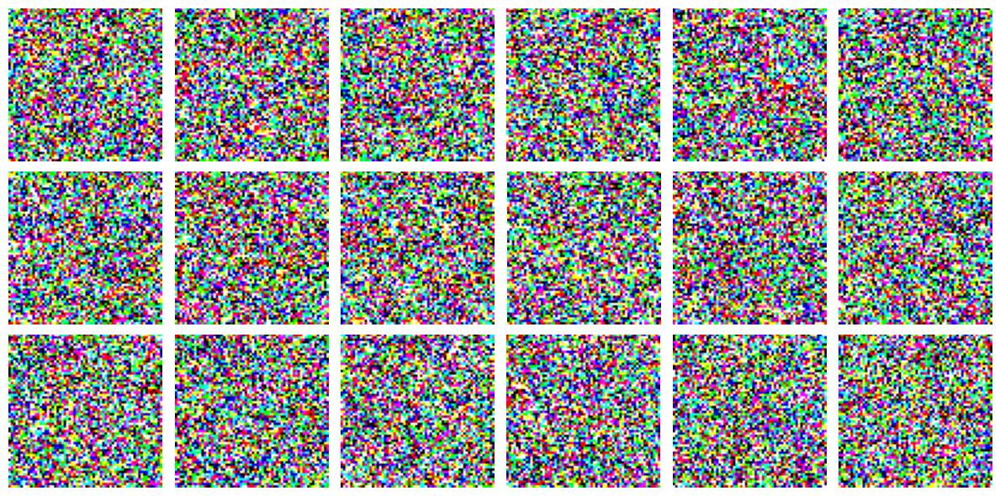

511/511 [==============================] - 142s 279ms/step - n_loss: 0.1683 - i_loss: 0.3142 - val_n_loss: 0.7408 - val_i_loss: 2.3361
Epoch 3/20
511/511 [==============================] - ETA: 0s - n_loss: 0.1620 - i_loss: 0.2866

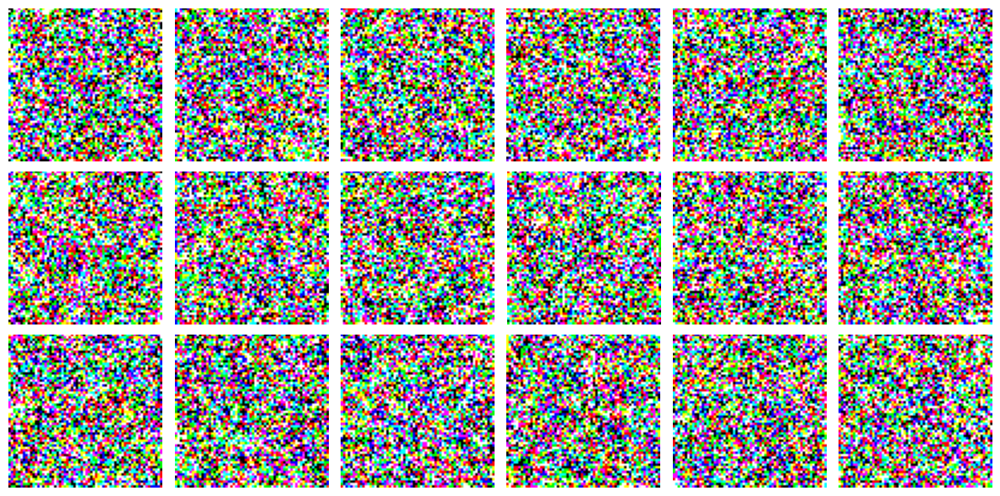

511/511 [==============================] - 143s 280ms/step - n_loss: 0.1620 - i_loss: 0.2866 - val_n_loss: 0.6278 - val_i_loss: 1.9079
Epoch 4/20
511/511 [==============================] - ETA: 0s - n_loss: 0.1592 - i_loss: 0.2794

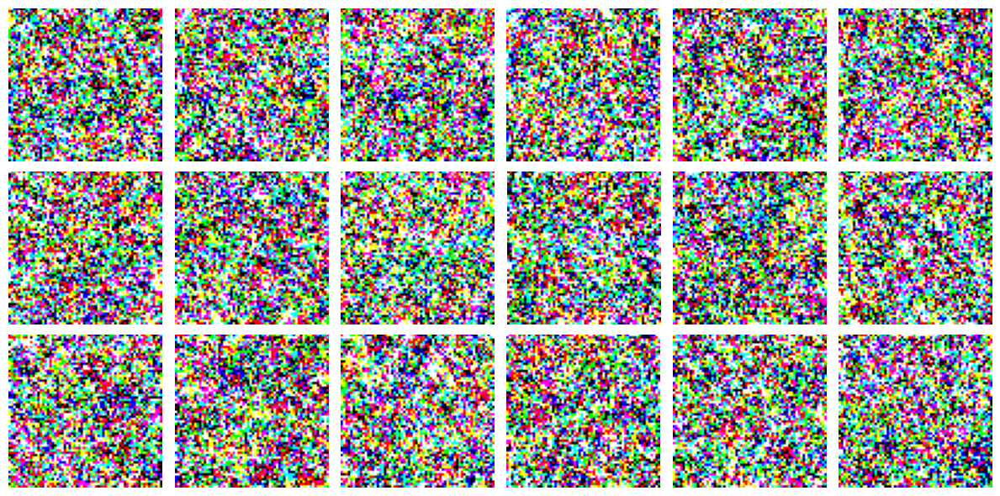

511/511 [==============================] - 143s 280ms/step - n_loss: 0.1592 - i_loss: 0.2794 - val_n_loss: 0.4957 - val_i_loss: 1.4510
Epoch 5/20
511/511 [==============================] - ETA: 0s - n_loss: 0.1605 - i_loss: 0.2870

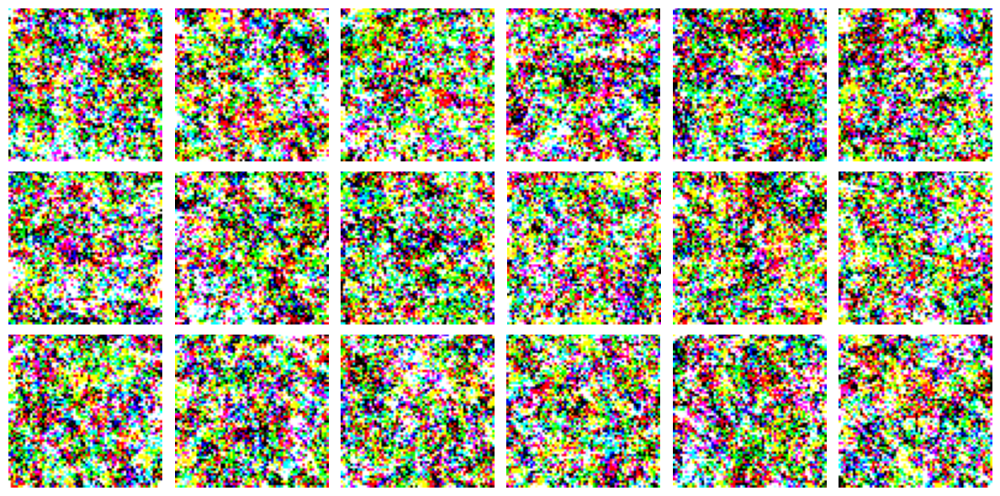

511/511 [==============================] - 143s 280ms/step - n_loss: 0.1605 - i_loss: 0.2870 - val_n_loss: 0.3727 - val_i_loss: 1.0791
Epoch 6/20
511/511 [==============================] - ETA: 0s - n_loss: 0.1588 - i_loss: 0.2763

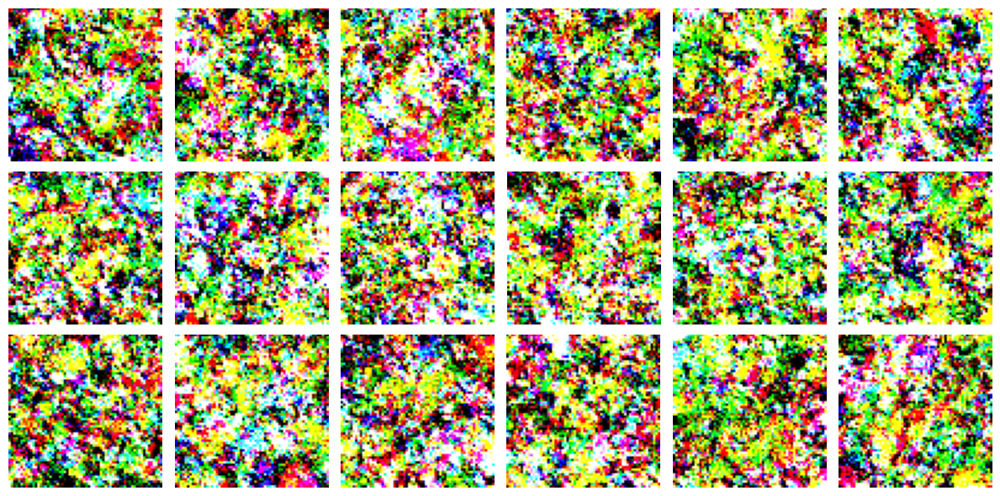

511/511 [==============================] - 144s 282ms/step - n_loss: 0.1588 - i_loss: 0.2763 - val_n_loss: 0.2837 - val_i_loss: 0.7996
Epoch 7/20
511/511 [==============================] - ETA: 0s - n_loss: 0.1556 - i_loss: 0.2680

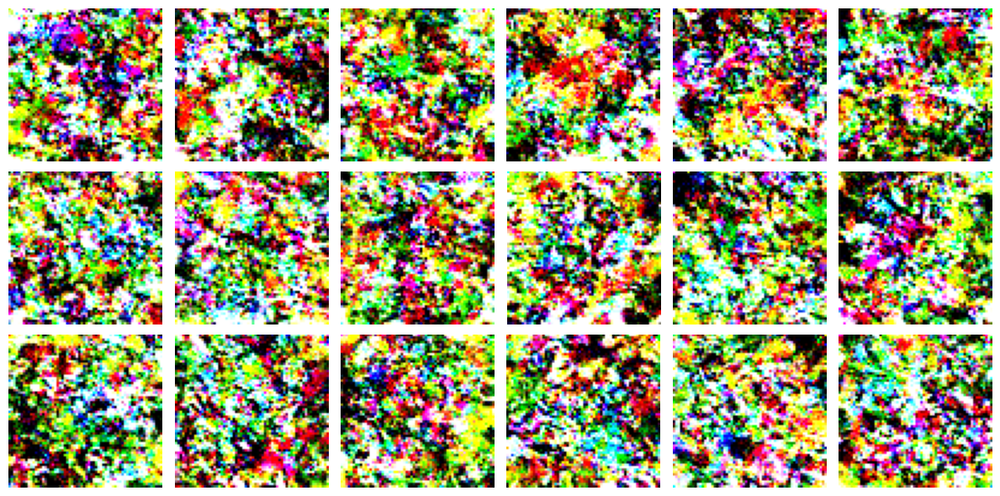

511/511 [==============================] - 144s 281ms/step - n_loss: 0.1556 - i_loss: 0.2680 - val_n_loss: 0.2237 - val_i_loss: 0.5853
Epoch 8/20
511/511 [==============================] - ETA: 0s - n_loss: 0.1551 - i_loss: 0.2646

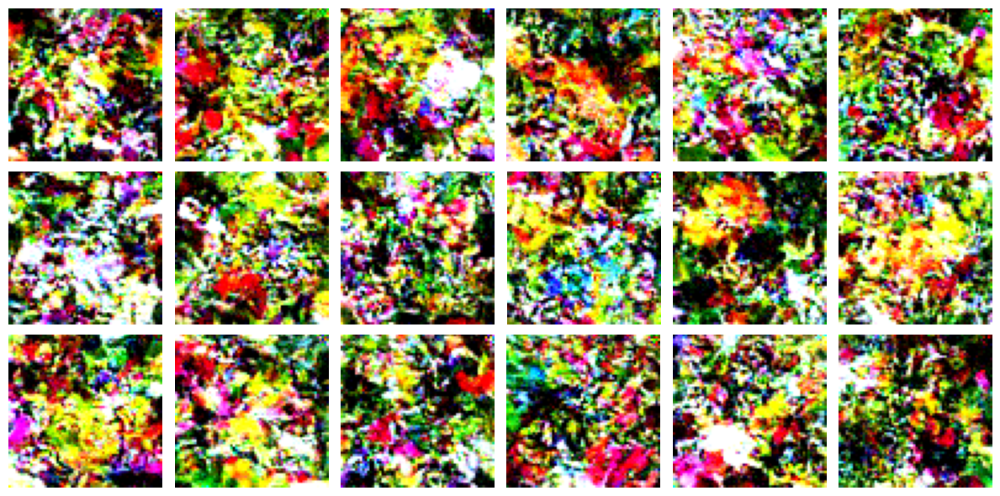

511/511 [==============================] - 144s 282ms/step - n_loss: 0.1551 - i_loss: 0.2646 - val_n_loss: 0.1863 - val_i_loss: 0.4105
Epoch 9/20
511/511 [==============================] - ETA: 0s - n_loss: 0.1544 - i_loss: 0.2681

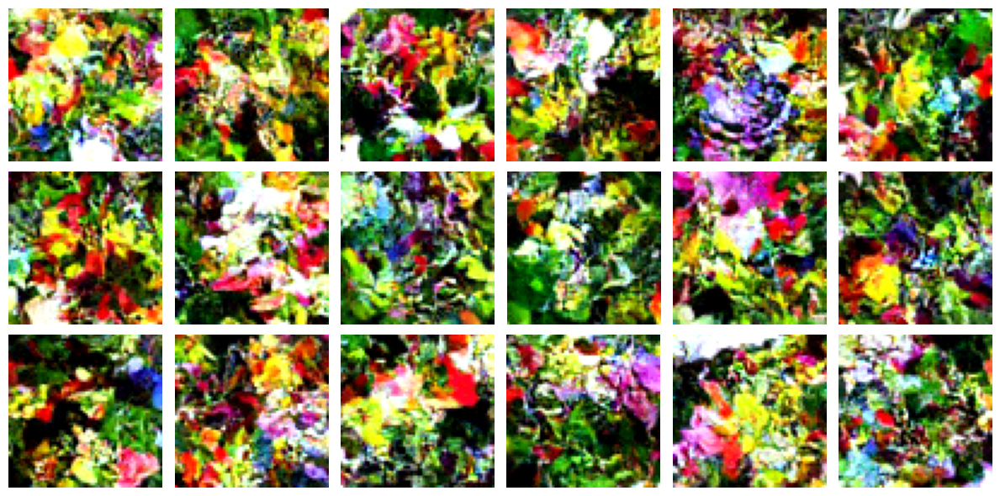

511/511 [==============================] - 142s 277ms/step - n_loss: 0.1544 - i_loss: 0.2681 - val_n_loss: 0.1675 - val_i_loss: 0.3159
Epoch 10/20
511/511 [==============================] - ETA: 0s - n_loss: 0.1537 - i_loss: 0.2617

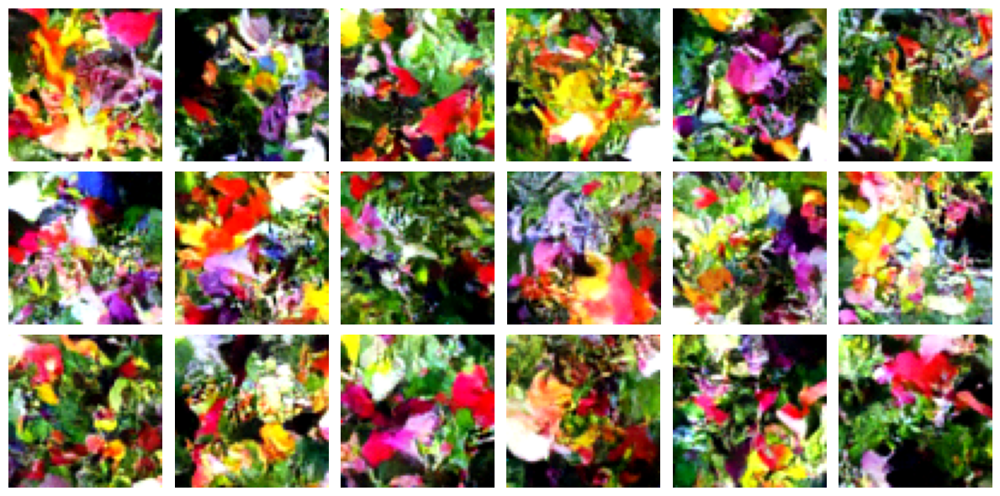

511/511 [==============================] - 144s 283ms/step - n_loss: 0.1537 - i_loss: 0.2617 - val_n_loss: 0.1586 - val_i_loss: 0.2853
Epoch 11/20
511/511 [==============================] - ETA: 0s - n_loss: 0.1521 - i_loss: 0.2611

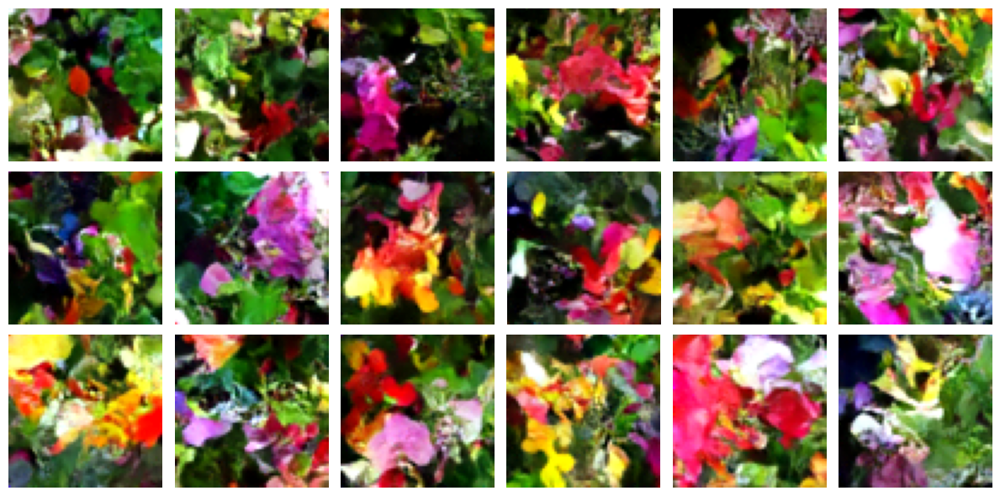

511/511 [==============================] - 154s 302ms/step - n_loss: 0.1521 - i_loss: 0.2611 - val_n_loss: 0.1540 - val_i_loss: 0.2598
Epoch 12/20
511/511 [==============================] - ETA: 0s - n_loss: 0.1518 - i_loss: 0.2558

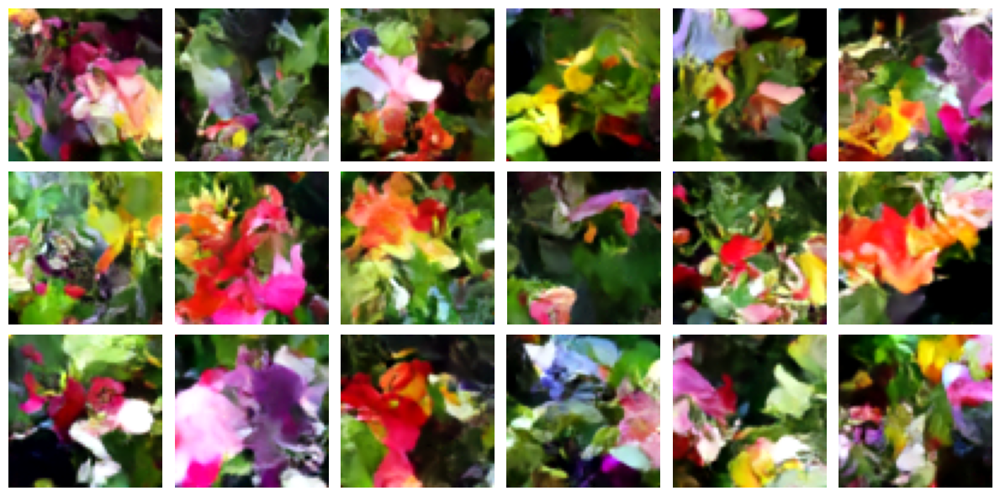

511/511 [==============================] - 153s 300ms/step - n_loss: 0.1518 - i_loss: 0.2558 - val_n_loss: 0.1514 - val_i_loss: 0.2496
Epoch 13/20
511/511 [==============================] - ETA: 0s - n_loss: 0.1514 - i_loss: 0.2548

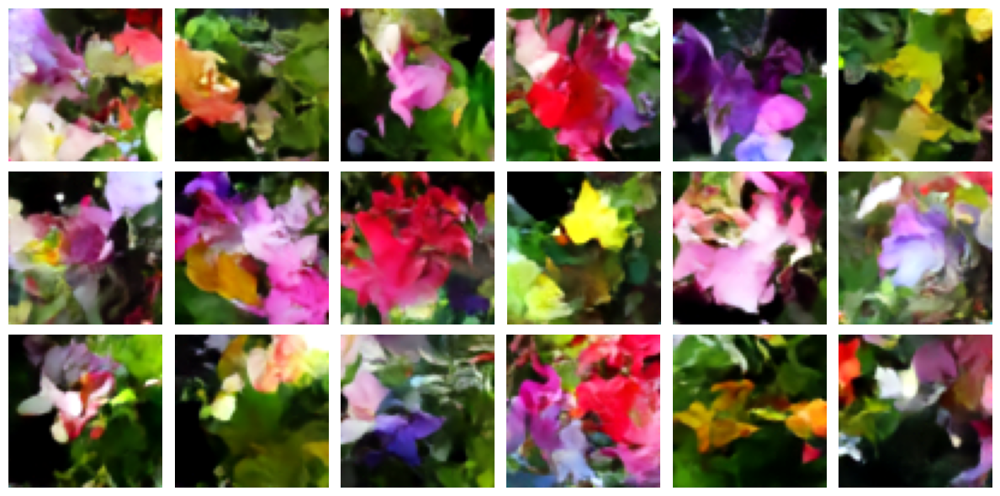

511/511 [==============================] - 145s 284ms/step - n_loss: 0.1514 - i_loss: 0.2548 - val_n_loss: 0.1502 - val_i_loss: 0.2467
Epoch 14/20
511/511 [==============================] - ETA: 0s - n_loss: 0.1530 - i_loss: 0.2640

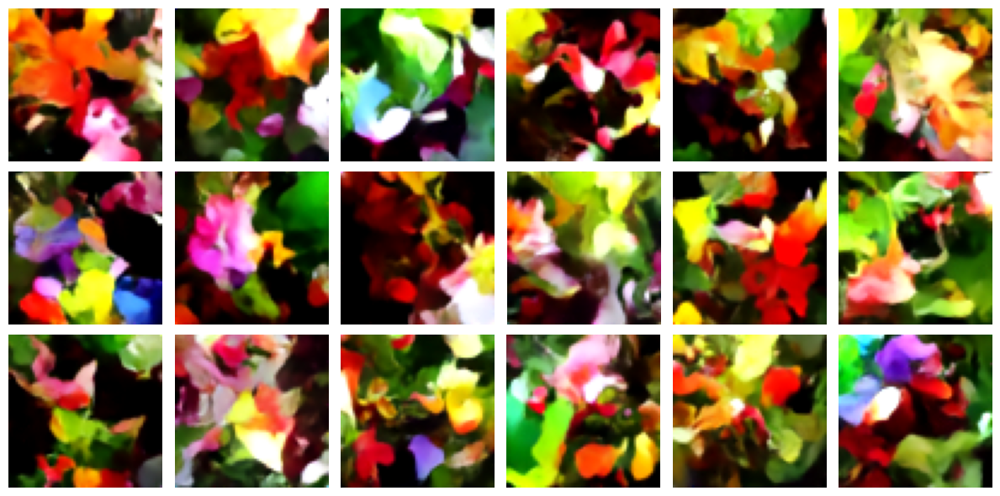

511/511 [==============================] - 155s 303ms/step - n_loss: 0.1530 - i_loss: 0.2640 - val_n_loss: 0.1499 - val_i_loss: 0.2603
Epoch 15/20
511/511 [==============================] - ETA: 0s - n_loss: 0.1512 - i_loss: 0.2538

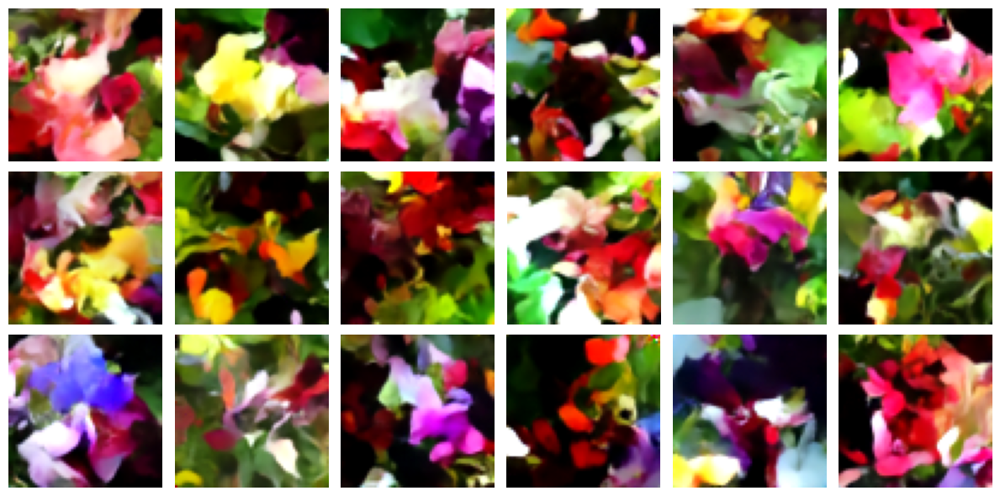

511/511 [==============================] - 144s 282ms/step - n_loss: 0.1512 - i_loss: 0.2538 - val_n_loss: 0.1495 - val_i_loss: 0.2507
Epoch 16/20
511/511 [==============================] - ETA: 0s - n_loss: 0.1499 - i_loss: 0.2536

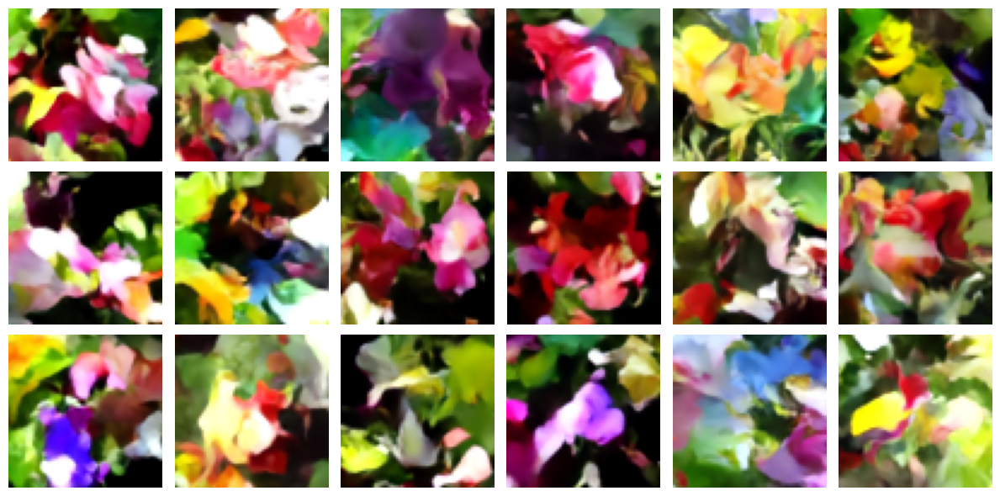

511/511 [==============================] - 155s 303ms/step - n_loss: 0.1499 - i_loss: 0.2536 - val_n_loss: 0.1482 - val_i_loss: 0.2485
Epoch 17/20
511/511 [==============================] - ETA: 0s - n_loss: 0.1500 - i_loss: 0.2527

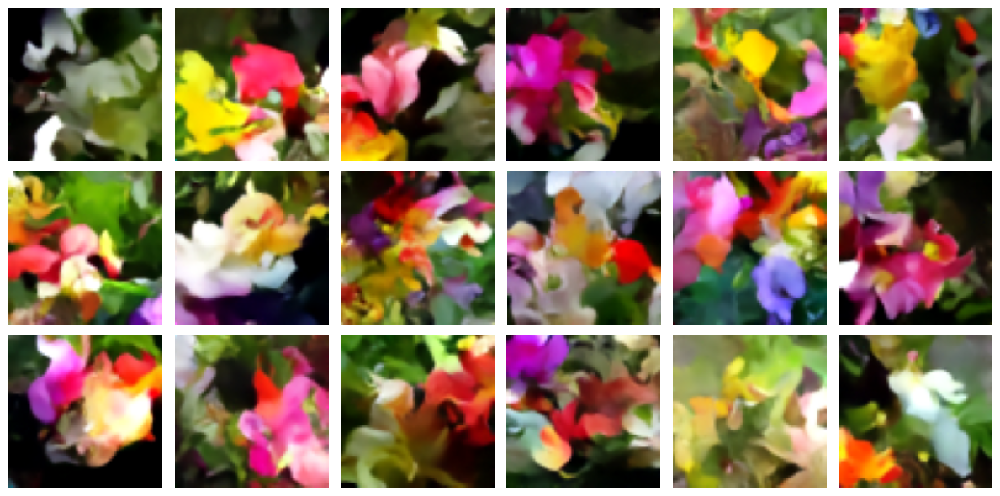

511/511 [==============================] - 156s 305ms/step - n_loss: 0.1500 - i_loss: 0.2527 - val_n_loss: 0.1476 - val_i_loss: 0.2447
Epoch 18/20
511/511 [==============================] - ETA: 0s - n_loss: 0.1490 - i_loss: 0.2512

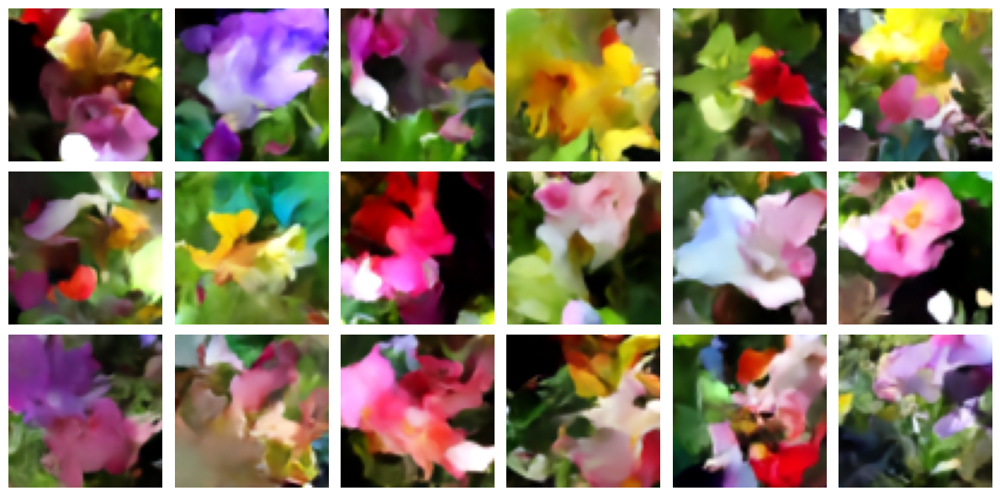

511/511 [==============================] - 142s 278ms/step - n_loss: 0.1490 - i_loss: 0.2512 - val_n_loss: 0.1474 - val_i_loss: 0.2434
Epoch 19/20
511/511 [==============================] - ETA: 0s - n_loss: 0.1505 - i_loss: 0.2525

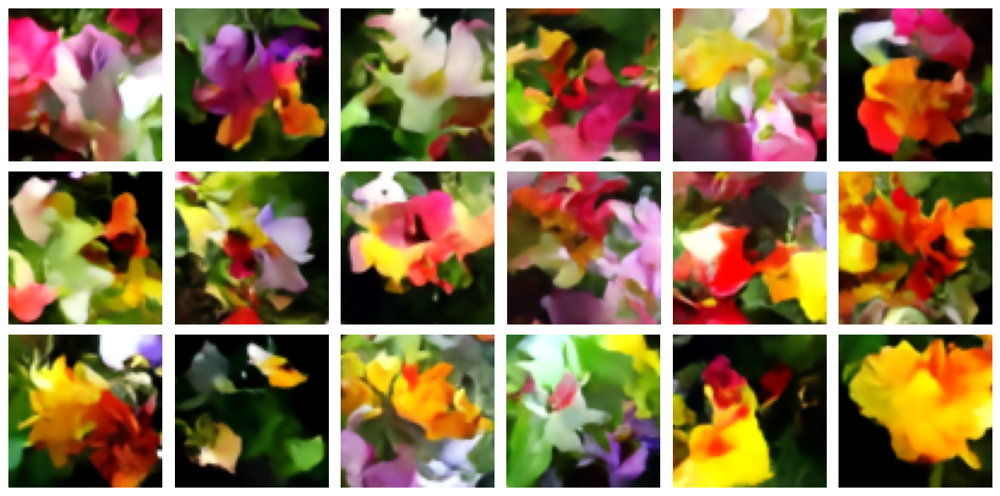

511/511 [==============================] - 154s 301ms/step - n_loss: 0.1505 - i_loss: 0.2525 - val_n_loss: 0.1492 - val_i_loss: 0.2423
Epoch 20/20
511/511 [==============================] - ETA: 0s - n_loss: 0.1493 - i_loss: 0.2494

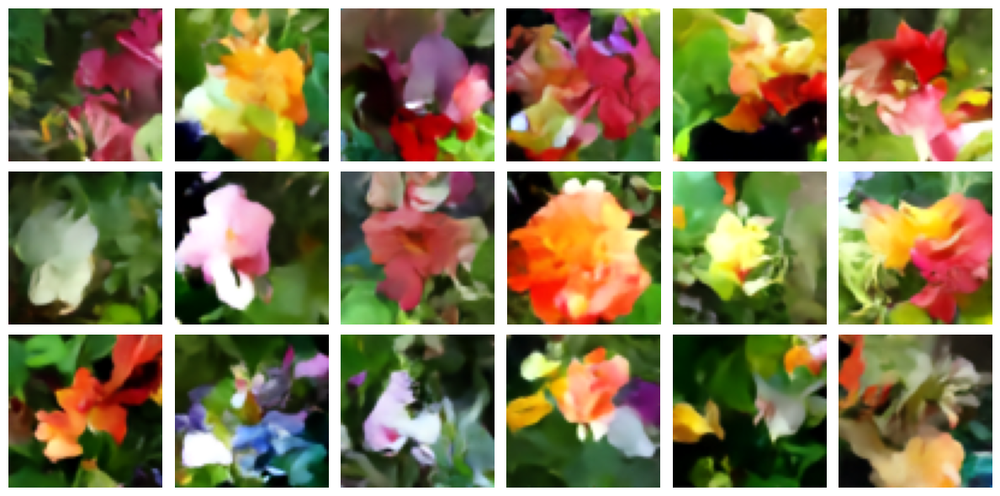

511/511 [==============================] - 142s 278ms/step - n_loss: 0.1493 - i_loss: 0.2494 - val_n_loss: 0.1467 - val_i_loss: 0.2415


In [31]:

# run training and plot generated images periodically
model.fit(
    train_dataset,
    epochs=20,
    validation_data=val_dataset,
    callbacks=[
        keras.callbacks.LambdaCallback(on_epoch_end=model.plot_images),
        #checkpoint_callback,
    ],
)


In [32]:
model.network.save_weights("VGGUnet_flowers")
model.ema_network.save_weights("VGGUnet_flowers_ema")

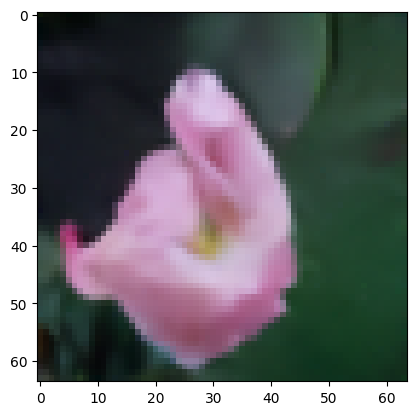

In [ ]:
image2 = model.generate(
            num_images=1,
            diffusion_steps=plot_diffusion_steps,
)
plt.imshow(image2[0])
plt.show()

# Same Seed Two Models

In [14]:
np.save("./flowers_sample_noises_grav",np.array(noises))
np.save("./flowers_sample_gens_grav",np.array(gens))

In [ ]:
np.save("./flowers_sample_gens2_grav",np.array(gens2))

In [21]:
noises = np.load("./flowers_sample_noises_grav.npy")
gens = np.load("./flowers_sample_gens_grav.npy")

In [13]:
noises = []
gens = []

for i in range(6):
    noise_sample = tf.random.normal(shape=(1, 64, 64, 3))
    generated_images = model.reverse_diffusion(noise_sample, 20)
    generated_images = model.denormalize(generated_images)
    noises.append(noise_sample)
    gens.append(generated_images[0])

In [22]:
gens3 = []

for i in range(6):
    generated_images = model.reverse_diffusion(noises[i], 20)
    generated_images = model.denormalize(generated_images)
    gens3.append(generated_images[0])

In [33]:
gens4 = []

for i in range(6):
    generated_images = model.reverse_diffusion(noises[i], 20)
    generated_images = model.denormalize(generated_images)
    gens4.append(generated_images[0])

<Figure size 640x480 with 0 Axes>

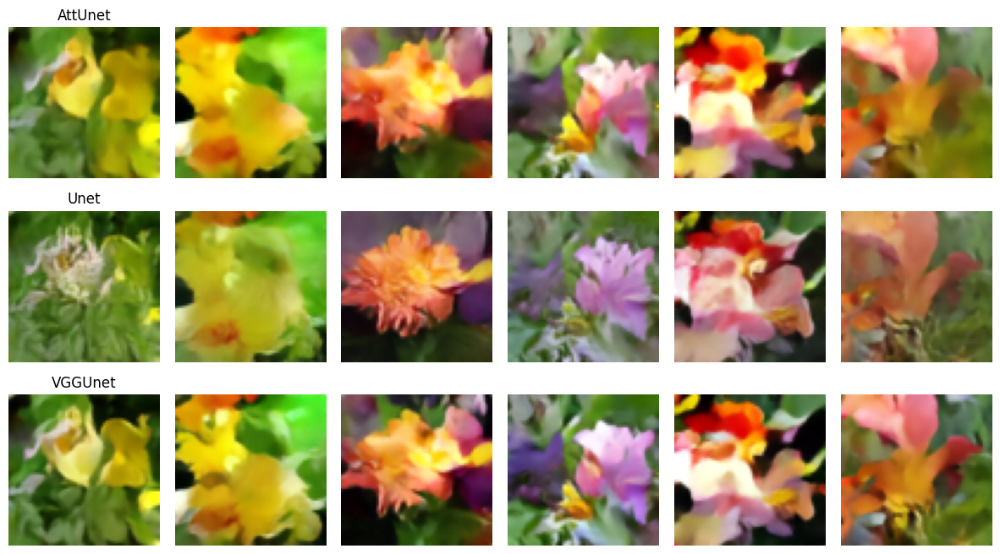

In [34]:
plt.figure()
#subplot(r,c) provide the no. of rows and columns
f, axarr = plt.subplots(3,6,figsize=(15, 8)) 
f.subplots_adjust(hspace=0.2,wspace=0.1)

# use the created array to output your multiple images. In this case I have stacked 4 images vertically
for i in range(6):
    axarr[0,0].set_title("AttUnet")
    axarr[1,0].set_title("Unet")
    axarr[2,0].set_title("VGGUnet")
    axarr[0,i].imshow(gens[i])
    axarr[1,i].imshow(gens3[i])
    axarr[2,i].imshow(gens4[i])
    axarr[0,i].axis('off')
    axarr[1,i].axis('off')
    axarr[2,i].axis('off')


